# Music Generation using LSTMs



---



# Getting and organizing the dataset

In [ ]:
%%bash
mkdir abcdownloads
for i in {1..21}
do
foo=$(printf "http://www.nigelgatherer.com/tunes/abc/tb%02d.abc" $i)
name=$(printf "tb%02d.abc" $i)
wget -O ./abcdownloads/$name "${foo}"
done

mkdir: cannot create directory ‘abcdownloads’: File exists
--2023-04-09 16:42:54--  http://www.nigelgatherer.com/tunes/abc/tb01.abc
Resolving www.nigelgatherer.com (www.nigelgatherer.com)... 162.215.118.153
Connecting to www.nigelgatherer.com (www.nigelgatherer.com)|162.215.118.153|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://www.nigelgatherer.com/tunes/abc/tb01.abc [following]
--2023-04-09 16:42:54--  https://www.nigelgatherer.com/tunes/abc/tb01.abc
Connecting to www.nigelgatherer.com (www.nigelgatherer.com)|162.215.118.153|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15248 (15K)
Saving to: ‘./abcdownloads/tb01.abc’

     0K .......... ....                                       100%  418K=0.04s

2023-04-09 16:42:54 (418 KB/s) - ‘./abcdownloads/tb01.abc’ saved [15248/15248]

--2023-04-09 16:42:54--  http://www.nigelgatherer.com/tunes/abc/tb02.abc
Resolving www.nigelgatherer.com (www.nigelgatherer.com)... 162.215.118.

<h2>Careful! This will delete the downloaded dataset. For experimentation, to re-download data
<h2>

In [ ]:
# Careful !


#!rm -rf abcdownloads

Importing and installing requirements

In [ ]:
%tensorflow_version 2.x
# Sets the tensorflow version to 2.x (choosing from 1.x and 2.x)

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

!pip install mitdeeplearning
import mitdeeplearning as mdl

import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Reading package lists... Done
Building dependency tree       
Reading state information... Done
abcmidi is already the newest version (20200122-1).
timidity is already the newest version (2.14.0-8build1).
0 upgraded, 0 newly installed, 0 to remove and 24 not upgraded.


GPU Not Necessary, but strongly recommended. On one instance, Training times observed were 8 minutes (GPU) v 7 hours (CPU)

In [ ]:
assert len(tf.config.list_physical_devices('GPU'))>0 
# Throws assertion error if no GPU

/usr/local/lib/python3.9/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# Data Cleaning, Preparation and Checking

In [ ]:
for i in range(1,2):
  with open('./abcdownloads/tb%02d.abc' %(i), "r+", encoding = "utf-8") as file:

      # Move the pointer (similar to a cursor in a text editor) to the end of the file
      file.seek(0, os.SEEK_END)

      # This code means the following code skips the very last character in the file -
      # i.e. in the case the last line is null we delete the last line
      # and the penultimate one
      pos = file.tell() - 2 
      if pos > 0:
          file.seek(pos, os.SEEK_SET)
          file.truncate()
for i in range(2,22):
  with open('./abcdownloads/tb%02d.abc' %(i), "r+", encoding = "utf-8") as file:

      # Move the pointer (similar to a cursor in a text editor) to the end of the file
      file.seek(0, os.SEEK_END)

      # This code means the following code skips the very last character in the file -
      # i.e. in the case the last line is null we delete the last line
      # and the penultimate one
      pos = file.tell() - 2 
      if pos > 0:
          file.seek(pos, os.SEEK_SET)
          file.truncate()
      file.seek(0, os.SEEK_END)
      file.write('\n')

In [ ]:
a = ''
for i in range(1,22):
  print(i)
  with open('./abcdownloads/tb%02d.abc' %(i), encoding='latin-1') as f:
    a = a + f.read()
a = a.split('\n\n')
print("No. of songs:", len(a))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
No. of songs: 1036


In [ ]:
a = '\n\n'.join(a)
mdl.lab1.extract_song_snippet(a)[:50]

Found 1041 songs in text


["X:001\nT:The Duke of Buccleugh's Tune\nB:Apollo's Banquet, 1990, via... \nB:The Popular Songs and Melodies of Scotland\nZ:Nigel Gatherer\nM:2/4\nL:1/8\nK:G\nG<EG<E|A>GAB|G<EG>A|B2 d z|\nGE/F/ GE|A>GAB|G<EG>A|B2 d z|]",
 "X:002\nT:I Fee'd a Lad at Michaelmas\nT:O Can You Labour Lea\nB:Johnson's Scots Musical Museum, via...\nB:The Popular Songs and Melodies of Scotland\nZ:Nigel Gatherer\nM:2/4\nL:1/8\nK:G\nG>GGB|A>GAB|G<GGB|e3 g|\nG>GGB|A>GAB|G<EE>D|G3|]",
 "X:003\nT:The Miller's Wedding\nT:The Miller's Daughter\nB:Cumming's Collection, 1780, via...\nB:The Popular Songs and Melodies of Scotland\nZ:Nigel Gatherer\nM:2/4\nL:1/8\nK:G\nD|G<GG>E|A>GAB|D<DE>D|G3 B|\nG<GG>E|A>GAB|D<DE>D|G3 z|]",
 "X:004\nT:John O'Groats Jig\nB:Kohlers Violin repository - slightly adapted\nC:John Bain, Wick\nZ:Nigel Gatherer\nM:6/8\nL:1/8\nO:Scottish\nR:jig\nK:Dm\nA/G/|FGA DFA|dfd ecA|Agf edc|=Bed c=BA|\nFGA DFA|dfd ecA|Bgf ed^c|dDD D2:|\nA|dfa afd|gbg ecA|dfa afd|=Bed c=BA|\ndfa afd|gbg ecA|Bgf ed^c|dDD D2:|"

In [ ]:
a = a.split('\n\n')
songs  = a
print(len(songs))
example_song = songs[3]
print("\nExample song: \n", example_song, sep='')

1036

Example song: 
X:004
T:John O'Groats Jig
B:Kohlers Violin repository - slightly adapted
C:John Bain, Wick
Z:Nigel Gatherer
M:6/8
L:1/8
O:Scottish
R:jig
K:Dm
A/G/|FGA DFA|dfd ecA|Agf edc|=Bed c=BA|
FGA DFA|dfd ecA|Bgf ed^c|dDD D2:|
A|dfa afd|gbg ecA|dfa afd|=Bed c=BA|
dfa afd|gbg ecA|Bgf ed^c|dDD D2:|


In [ ]:
mdl.lab1.play_song(a[5])

In [ ]:
# Join list of songs into a single string containing all songs
songs_all = "\n\n".join(songs)

# Unique characters
print("Total characters:", len(songs_all))
vocab = sorted(set(songs_all))
print("There are", len(vocab), "unique characters in the dataset")

Total characters: 346405
There are 106 unique characters in the dataset


<h1>Vectorizing<h1>

In [ ]:
# A mapping for characters to numbers and one for numbers to characters
chartoidx = {c:i for i, c in enumerate(vocab)}
def chartoidxfnc(string):
  return chartoidx[string]

idxtochar = np.array(vocab)

for char, idx in zip(chartoidx, range(20)):
  print(repr(char), chartoidxfnc(char))

'\x01' 0
'\n' 1
' ' 2
'!' 3
'"' 4
'#' 5
'%' 6
'&' 7
"'" 8
'(' 9
')' 10
'+' 11
',' 12
'-' 13
'.' 14
'/' 15
'0' 16
'1' 17
'2' 18
'3' 19


In [ ]:
def vectorize_string(string):
  v_string = map(chartoidxfnc, list(string))
  v_string = list(v_string)
  return np.array(v_string)

print(len(list(songs_all)))  # Gives total num of chars in dataset
vectorized_songs = vectorize_string(songs_all)

# Some quick checking

print(repr(songs_all[:10]))
print(idxtochar[vectorized_songs[:10]])
print(vectorized_songs[:10])
vectorized_songs.shape[0]

346405
'X:001\nT:Th'
['X' ':' '0' '0' '1' '\n' 'T' ':' 'T' 'h']
[56 26 16 16 17  1 52 26 52 71]


346405

# Creating Training Data

In [ ]:
# Creating training examples

def get_batch(vectorized_songs, seq_length, batch_size):

  n = vectorized_songs.shape[0]

  # Randomly choosing starting indices for the examples
  idx = np.random.choice(n - seq_length, batch_size)
  # Chooses (batch_size) number of integers in range(n-seq_length)
  # As last sequence starting point must be maximum n-seq_length to avoid
  # out of range

  # Getting the input sequences
  input_batch = [vectorized_songs[start : start+seq_length] for start in idx]
  # Output sequences (shifting forward input sequences by 1)
  output_batch = [vectorized_songs[start+1 : start+seq_length+1] for start in idx]

  # Inputs and true targets (to train on and measure performance against)
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  # batch_size number of sequences of length seq_length
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch


In [ ]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)
# Gives 1 batch of sequence length 5

for i, (input_idx, target_idx) in enumerate(
    zip(np.squeeze(x_batch), np.squeeze(y_batch))):
  print("Timestep", i)
  print("Input: {} ({})".format(input_idx, repr(idxtochar[input_idx])))
  print("Expected output: {} ({})".format(target_idx, repr(idxtochar[target_idx])))

Timestep 0
Input: 81 ('r')
Expected output: 72 ('i')
Timestep 1
Input: 72 ('i')
Expected output: 64 ('a')
Timestep 2
Input: 64 ('a')
Expected output: 2 (' ')
Timestep 3
Input: 2 (' ')
Expected output: 40 ('H')
Timestep 4
Input: 40 ('H')
Expected output: 78 ('o')


# Defining the model

In [ ]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
      rnn_units,
      return_sequences=True,
      recurrent_initializer='glorot_uniform',
      recurrent_activation='sigmoid',
      stateful=True
  )

def def_model(vocab_size, embedding_dims, rnn_units, batch_size):
  model = tf.keras.Sequential([
                               tf.keras.layers.Embedding(vocab_size,
                                                         embedding_dims,
                                                         batch_input_shape=[batch_size, None]
                                                         ),
                               
                               LSTM(rnn_units),

                               # A fully connected layer

                               tf.keras.layers.Dense(vocab_size)
  ])

  return model



In [ ]:
model = def_model(len(vocab), embedding_dims=256, rnn_units=1024, batch_size=32)
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           27136     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 106)           108650    
                                                                 
Total params: 5,382,762
Trainable params: 5,382,762
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# Checking out the form of input and output

x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
# Returns 32 sequences of sequence length 100 characters to x
pred = model(x)
print("Input shape: ", x.shape,
      "\nPrediction/Output shape: ", pred.shape, " # (Batch size, seq_length, vocab size)")

Input shape:  (32, 100) 
Prediction/Output shape:  (32, 100, 106)  # (Batch size, seq_length, vocab size)


<h1>Predictions from untrained model</h1>

In [ ]:
sample_indices = tf.random.categorical(pred[0], num_samples=1)
sample_indices = tf.squeeze(sample_indices, axis=-1).numpy()
print(sample_indices)
print(repr(''.join(idxtochar[x[0]])))  # Inputs
print(repr(''.join(idxtochar[sample_indices])))

[ 17  85  49  18  41  24 102  31  27  16  67  26 102  72  84  61 102  33
  98  22  57  57  38  70  65  72  62  90  53  49  48  63  90  38  51  38
  92  12  22  39  13 102  40  87  27  76  34  61  27  55  52  46  92  70
  64  53  69  23  18  87  39  61  38  78  74  57  81  62  16  40  13  12
  97   6  22 105  78  46  99  26  98   5  12  91  17  98  56  81   7  49
  68  78  98  34  12  13  26 105  35 104]
'd/B/ A>B|AA/B/ A/B/d/e/|fe ed/e/|\nff/a/ g/f/e/d/|B/c/d/B/ A>B|AA/B/ A/B/d/e/|fd d:|\nd/e/|ff/g/ f/e/d'
'1vQ2I8é?;0d:éiu]éAÕ6YYFgbi^{UQP_{FSF},6G-éHx;mB];WTN}gaUf72xG]FokYr^0H-,Ó%6úoNÙ:Õ#,|1ÕXr&QeoÕB,-:úCò'


# Training the model

In [ ]:
def loss_fn(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(
      labels,
      logits,
      from_logits=True
  )

  return loss

In [ ]:
example_batch_loss = loss_fn(y, pred)

print("Scalar loss: ", example_batch_loss.numpy().mean())

Scalar loss:  4.6643214


In [ ]:
# Hyperparameters

num_iterations = 8000
batch_size = 5
seq_length = 149
learning_rate = 3e-3

vocab_size = len(vocab)
embedding_dims = 256
rnn_units = 1024

checkpoint_dir = '/content/drive/MyDrive/MIT_6S191/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, 'nigeldatamusic_ckpt')

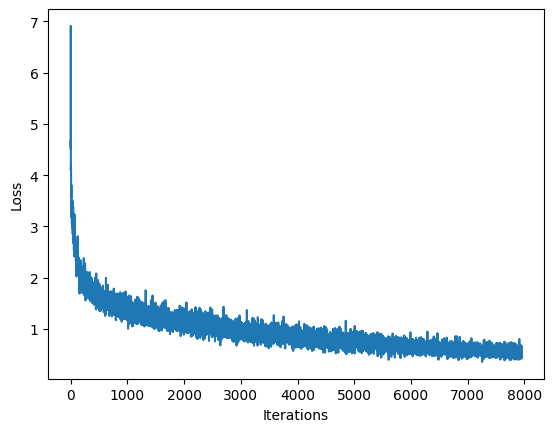

100%|██████████| 8000/8000 [05:31<00:00, 24.11it/s]


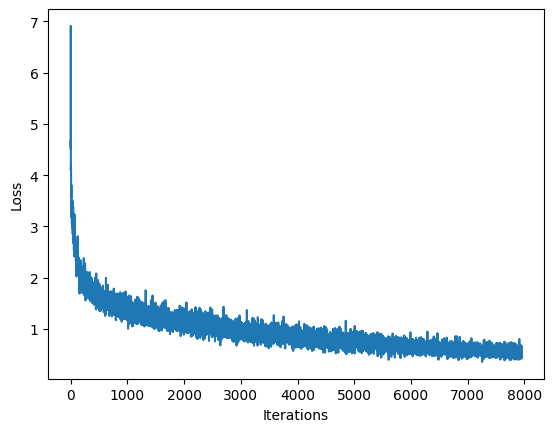

In [ ]:

model = def_model(vocab_size, embedding_dims, rnn_units, batch_size)
optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

@tf.function  # Converts function to callable tensorflow graph
def train_step(x, y):
  # Using tf.GradientTape() to later perform backpropagation easily
  with tf.GradientTape() as tape:
    y_sharp = model(x)  # Predictions
    loss = loss_fn(y, y_sharp)  # Loss btw true and predicted values
  
  gradients = tape.gradient(loss, model.trainable_variables)
  # This is to ensure that the backpropagation performed gets gradients
  # w.r.t all model parameters

  # Applying the gradients to update the parameters of the model
  optimizer.apply_gradients(zip(gradients, model.trainable_variables))
  return loss

# Training the model

history = []  # To plot the graph
plotter = mdl.util.PeriodicPlotter(sec=5, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'):
  tqdm._instances.clear()

# tqdm is used to give a useful progress bar and status of the operation

for iter in tqdm(range(num_iterations)):

  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  history.append(loss.numpy().mean())
  plotter.plot(history)

  if iter % 100 == 0:
    model.save_weights(checkpoint_prefix)
  # Checkpoint updated every hundred iterations
  # The weights of the model itself are updated every time loss_fn is called

model.save_weights(checkpoint_prefix)  # Saving final trained weights
model.save(os.path.join(checkpoint_dir, 'MusicNigelModel1.h5'))

In [ ]:
print(loss)

tf.Tensor(
[[6.52488136e+00 4.99772024e+00 1.38403773e+00 4.37790918e+00
  5.04447101e-03 1.68786108e-04 1.59828770e+00 1.83328164e+00
  3.86188507e-01 4.63947582e+00 2.42323232e+00 1.15142800e-02
  5.94186187e-01 1.26840281e+00 2.04084232e-01 3.60182315e-01
  4.75721598e-01 7.09282607e-02 8.51565838e-01 5.69897771e-01
  1.96406245e+00 3.07600319e-01 2.47447868e-04 3.69468108e-02
  1.50838137e-01 2.71498151e-02 3.18283746e-05 1.23135615e-04
  7.52561465e-02 1.03536718e-01 5.19900210e-02 5.19474670e-02
  1.75678778e+00 4.97400880e-01 5.21980040e-02 1.70141347e-02
  2.25595045e+00 2.01535061e-01 2.12580562e-01 2.55939156e-01
  3.27732936e-02 3.99535269e-01 1.35360897e-01 1.97365731e-02
  1.68328136e-02 1.69098377e-03 9.49114442e-01 1.65381972e-02
  3.24632794e-01 3.14421281e-02 9.61352214e-02 8.51050317e-02
  1.50441408e-01 7.75706349e-03 5.81453030e-04 4.38177623e-02
  4.78607476e-01 1.15710831e+00 2.01142251e-01 2.46689707e-01
  5.30881668e-03 1.49558711e+00 8.14478695e-01 1.16399460e-

<h1>Using the model to generate music</h1>

In [ ]:
%%bash
mkdir songs
mkdir fullsongs
apt update
apt install ffmpeg

Hit:1 https://cloud.r-project.org/bin/linux/ubuntu focal-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Hit:4 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal InRelease
Hit:5 http://archive.ubuntu.com/ubuntu focal InRelease
Get:6 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Hit:7 http://ppa.launchpad.net/cran/libgit2/ubuntu focal InRelease
Hit:8 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal InRelease
Get:9 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Hit:10 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu focal InRelease
Hit:11 http://ppa.launchpad.net/ubuntugis/ppa/ubuntu focal InRelease
Get:12 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 Packages [1,324 kB]
Get:13 http://archive.ubuntu.com/ubuntu focal-updates/restricted amd64 Packages [2,199 kB]
Get:14 http://archive.

mkdir: cannot create directory ‘songs’: File exists
mkdir: cannot create directory ‘fullsongs’: File exists






In [ ]:
model = def_model(vocab_size, embedding_dims, rnn_units, batch_size=1)
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))


'''
model = tf.keras.models.load_model(os.path.join(checkpoint_dir, 'MusicNigelModel1.h5'))
model = def_model(vocab_size, embedding_dims, rnn_units, batch_size=1)
model.build(tf.TensorShape([1, None]))
'''

model.summary()

/usr/local/lib/python3.9/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (1, None, 256)            27136     
                                                                 
 lstm_2 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_2 (Dense)             (1, None, 106)            108650    
                                                                 
Total params: 5,382,762
Trainable params: 5,382,762
Non-trainable params: 0
_________________________________________________________________


In [ ]:

def gen_song(model, start_string, gen_length=1000):

  input_eval = [chartoidx[s] for s in start_string]
  input_eval = tf.expand_dims(input_eval, 0)

  song_gen = []

  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(gen_length)):
    predictions = model(input_eval)
    predictions = tf.squeeze(predictions, 0)
    predicted_id = tf.random.categorical(predictions, num_samples=1)[-1, 0].numpy()
    
    input_eval = tf.expand_dims([predicted_id], 0)
    song_gen.append(idxtochar[predicted_id])

  return (start_string+''.join(song_gen))

In [ ]:
tot = 0
!mkdir songs

mkdir: cannot create directory ‘songs’: File exists


In [ ]:

song_generated = gen_song(model, start_string="X", gen_length=1000)

last_bracket_index = song_generated.rfind("]")
if last_bracket_index != -1:
    song_generated = song_generated[:last_bracket_index+1]

all_songs_play = mdl.lab1.extract_song_snippet(song_generated)
print(all_songs_play)


for i, song in enumerate(all_songs_play):
    waveform = mdl.lab1.play_song(song)

    if waveform:
      with open('./songs/gensong%02d.wav' %(tot), 'wb') as f:
        f.write(waveform.data)
      with open('./songs/songnames.txt', 'a') as f:
        f.write("file 'gensong%02d.wav'\n" %(tot))
      #print("Generated song", tot)
      tot += 1



text_file = open("tune.abc", "w")

for i, song in enumerate(all_songs_play):
  print(song)
  text_file.write(song)

text_file.close()

100%|██████████| 1000/1000 [00:09<00:00, 107.58it/s]

Found 1 songs in text
['X:473\nT:Pat Carnach, Beec| afga ^gaeA | =g2 f2 e2\nag | fede cAAc | d2 fd ceef  |\n    E3  | F2 [E2C2] | \n[E2G,2] [E2C2] | G>^F A>G (3=FED | [C4E4] :|\nfe>c | d>cB<d F2 c2 | [D2B,2] [D2B,2] | \n[D2G,2] [D2B,2] | \n[D2G,2] [D2B,2] | \n[D2G,2] [D2B,2] | \nc z | d2 (3edc d>c G2 | B2 B2  B2    | A2 F2 | F2 E2 E2\ndf | e2 ce ceef  | eAAB cAce | faag fdec | Afec B2|G6 |]']
X:473
T:Pat Carnach, Beec| afga ^gaeA | =g2 f2 e2
ag | fede cAAc | d2 fd ceef  |
    E3  | F2 [E2C2] | 
[E2G,2] [E2C2] | G>^F A>G (3=FED | [C4E4] :|
fe>c | d>cB<d F2 c2 | [D2B,2] [D2B,2] | 
[D2G,2] [D2B,2] | 
[D2G,2] [D2B,2] | 
[D2G,2] [D2B,2] | 
c z | d2 (3edc d>c G2 | B2 B2  B2    | A2 F2 | F2 E2 E2
df | e2 ce ceef  | eAAB cAce | faag fdec | Afec B2|G6 |]


In [ ]:
!ffmpeg -f concat -i ./songs/songnames.txt -c copy ./fullsongs/fullsong.wav

ffmpeg version 4.2.7-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.4.0-1ubuntu1~20.04.1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --e

In [ ]:
%%bash
#rm -rf songs 
ffmpeg -i ./fullsongs/fullsong.wav -vn -ar 44100 -ac 2 -b:a 192k ./fullsongs/fullsong.mp3

ffmpeg version 4.2.7-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.4.0-1ubuntu1~20.04.1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --e

CalledProcessError: ignored

In [ ]:
import subprocess

# Load ABC notation from a file
with open('tune.abc') as f:
    abc_notation = f.read()

# Convert ABC notation to MIDI format using abc2midi
midi_data = subprocess.check_output(['abc2midi', '-'], input=abc_notation.encode(), stderr=subprocess.PIPE)

# Save the MIDI data to a file
with open('outpuut.mid', 'wb') as f:
    f.write(midi_data)